# IFT 6758 - Devoir 2

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
RAW_CSV_PATH = "./data/audio_segments.csv"
CLEAN_CSV_PATH = "./audio_segments_clean.csv"

## Question 1

### a)
Commencez par utiliser les fonctions créées dans `q1.py` pour rendre les données plus informatives et lisibles. Concrètement, remplissez les cellules suivantes :


In [3]:
import pandas as pd
import numpy as np
import time
import matplotlib.pyplot as plt
import seaborn as sns
from q1 import count_labels, convert_id, convert_ids, contains_label, get_correlation

sns.set(style="ticks")

In [4]:
# Charger le fichier `audio_segments.csv` dans un DataFrame `df`
df = pd.read_csv(RAW_CSV_PATH)
# df.columns = df.columns.str.strip()

In [5]:
# Ajouter une colonne correspondant au nombre d'étiquettes appelée `label_count`
# Ici, il y a un problème ennuyeux avec l'accès à la colonne positive_labels
df = df.assign(label_count = df[" positive_labels"].apply(count_labels))

In [6]:
# Ajouter une nouvelle colonne appelée `label_names` avec les noms d'étiquette traités au lieu de l'ID d'étiquette

# Imprimer le temps pris pour cette opération (soit en utilisant le module time ou timeit).
# Puisque nous n'exécutons ce code qu'une fois, ce n'est pas très problématique que cela prenne quelques minutes.
# Cependant, pour un ensemble de données plus volumineux, cela vaudrait la peine de l'accélérer
# (par exemple en créant un dictionnaire ID -> nom une fois et en l'utilisant).

%timeit df["label_names"] = df[" positive_labels"].apply(convert_ids)

13.4 ms ± 179 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [7]:
# Affichez le DataFrame et enregistrez-le dans `audio_segments_clean.csv` (sans index)

print(df)
df.to_csv(CLEAN_CSV_PATH, index=False)

            # YTID   start_seconds   end_seconds  \
0      --4gqARaEJE             0.0          10.0   
1      --BfvyPmVMo            20.0          30.0   
2      --U7joUcTCo             0.0          10.0   
3      --i-y1v8Hy8             0.0           9.0   
4      -0BIyqJj9ZU            30.0          40.0   
...            ...             ...           ...   
20366  zyF8TGSRvns           150.0         160.0   
20367  zz35Va7tYmA            30.0          40.0   
20368  zzD_oVgzKMc            30.0          40.0   
20369  zzNdwF40ID8            70.0          80.0   
20370  zzbTaK7CXJY            30.0          40.0   

                               positive_labels  label_count  \
0        /m/068hy,/m/07q6cd_,/m/0bt9lr,/m/0jbk            4   
1                                     /m/03l9g            1   
2                                    /m/01b_21            1   
3      /m/04rlf,/m/09x0r,/t/dd00004,/t/dd00005            4   
4             /m/07rgt08,/m/07sq110,/t/dd00001            3 

### b)

Ensuite, à l'aide du DataFrame propre, remplissez les cellules suivantes pour mieux comprendre la distribution des étiquettes dans l'ensemble de données. Pour chaque graphique ci-dessous, assurez-vous d'inclure les **noms d'axe** appropriés et un **titre**.

In [8]:
df = pd.read_csv(CLEAN_CSV_PATH)

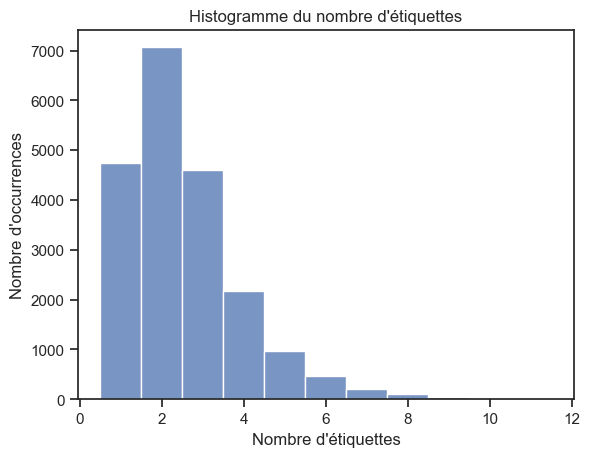

In [9]:
# À l'aide de seaborn, créez un histogramme du nombre d'étiquettes des rangées dans le DataFrame
sns.histplot(
    df, x="label_count",
    discrete=True,
)

plt.xlabel("Nombre d'étiquettes")
plt.ylabel("Nombre d'occurrences")
plt.title("Histogramme du nombre d'étiquettes")
plt.show()

Suivez les étapes ci-dessous pour créer un heatmap montrant la "corrélation" entre différentes étiquettes.
- Plus précisément, chaque cellule de la heatmap doit correspondre à la probabilité qu'un échantillon avec l'étiquette de ligne correspondante ait également l'étiquette de colonne correspondante.
- Considérez simplement les étiquettes ["Piano", "Classical music", "Speech", "Conversation", "Screaming"].

Votre graphique final devrait ressembler à ceci :

![alt text](images/heatmap.png "Heatmap")

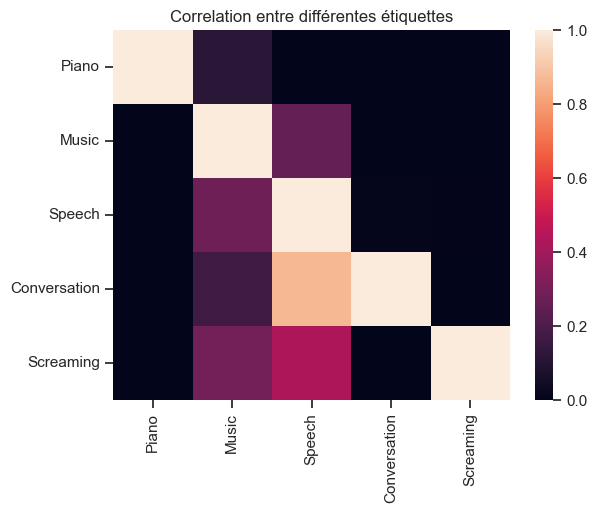

In [10]:
labels = ["Piano", "Music", "Speech", "Conversation", "Screaming"]

# Il y a plusieurs façons d'aborder cela, la façon que nous recommandons ici est de construire d'abord une grille 2D où chaque
# value est la valeur de corrélation entre la ligne/colonne correspondante à l'aide des fonctions créées dans q1.py.
correlation_grid = [[get_correlation(df["label_names"], label_1, label_2) for label_2 in labels] for label_1 in labels]
        
# Ensuite, à l'aide de sns.heatmap, créez la heatmap, en profitant de xticklabels et yticklabels pour définir les noms des étiquettes comme valeurs de graduation
sns.heatmap(correlation_grid, xticklabels=labels, yticklabels=labels)
plt.title("Correlation entre différentes étiquettes")
plt.show()

## Question 2
La question 2 n'a pas de composante notebook, remplissez simplement le fichier `q2.py`.

## Question 3

Téléchargez l'audio pour les étiquettes suivantes à l'aide des fonction créées dans `q3.py`

In [11]:
from q3 import data_pipeline, rename_files, filter_df

In [12]:
# Téléchargez "Cough"
label = "Cough"
data_pipeline(CLEAN_CSV_PATH, label)

# Renommez les fichiers pour inclure le début et fin des échantillons ainsi que la durée
rename_files(f"./audio/{label}_cut", CLEAN_CSV_PATH)

0it [00:00, ?it/s]

File already exists at ./audio/Cough_raw/--U7joUcTCo.mp3
File already cut at ./audio/Cough_cut/--U7joUcTCo.mp3
File already exists at ./audio/Cough_raw/0iiwZ2_9Vi8.mp3
File already cut at ./audio/Cough_cut/0iiwZ2_9Vi8.mp3
File already exists at ./audio/Cough_raw/0mZQ6Q-viPw.mp3
File already cut at ./audio/Cough_cut/0mZQ6Q-viPw.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=130v5XJl8G0
[youtube] 130v5XJl8G0: Downloading webpage
[youtube] 130v5XJl8G0: Downloading ios player API JSON
[youtube] 130v5XJl8G0: Downloading web creator player API JSON


ERROR: [youtube] 130v5XJl8G0: This video has been removed for violating YouTube's Terms of Service
4it [00:00,  8.82it/s]

Error while downloading 130v5XJl8G0: ERROR: [youtube] 130v5XJl8G0: This video has been removed for violating YouTube's Terms of Service
File already exists at ./audio/Cough_raw/1Xmw9VUzvLY.mp3
File already cut at ./audio/Cough_cut/1Xmw9VUzvLY.mp3
File already exists at ./audio/Cough_raw/39IZIbmQPzA.mp3
File already cut at ./audio/Cough_cut/39IZIbmQPzA.mp3
File already exists at ./audio/Cough_raw/3Liy9uBgsQM.mp3
File already cut at ./audio/Cough_cut/3Liy9uBgsQM.mp3
File already exists at ./audio/Cough_raw/3id3zRRZBVM.mp3
File already cut at ./audio/Cough_cut/3id3zRRZBVM.mp3
File already exists at ./audio/Cough_raw/40fIOkLK3j4.mp3
File already cut at ./audio/Cough_cut/40fIOkLK3j4.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=5wbc84KnDS0
[youtube] 5wbc84KnDS0: Downloading webpage
[youtube] 5wbc84KnDS0: Downloading ios player API JSON
[youtube] 5wbc84KnDS0: Downloading web creator player API JSON


ERROR: [youtube] 5wbc84KnDS0: This video has been removed for violating YouTube's Terms of Service
10it [00:00, 11.07it/s]

Error while downloading 5wbc84KnDS0: ERROR: [youtube] 5wbc84KnDS0: This video has been removed for violating YouTube's Terms of Service
[youtube] Extracting URL: https://www.youtube.com/watch?v=7lO9BbTaezE
[youtube] 7lO9BbTaezE: Downloading webpage
[youtube] 7lO9BbTaezE: Downloading ios player API JSON
[youtube] 7lO9BbTaezE: Downloading web creator player API JSON


ERROR: [youtube] 7lO9BbTaezE: Private video. Sign in if you've been granted access to this video
12it [00:01,  8.30it/s]

Error while downloading 7lO9BbTaezE: ERROR: [youtube] 7lO9BbTaezE: Private video. Sign in if you've been granted access to this video
File already exists at ./audio/Cough_raw/9h3a7fN0f-c.mp3
File already cut at ./audio/Cough_cut/9h3a7fN0f-c.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=AIVt3e5EVtc
[youtube] AIVt3e5EVtc: Downloading webpage
[youtube] AIVt3e5EVtc: Downloading ios player API JSON
[youtube] AIVt3e5EVtc: Downloading web creator player API JSON


ERROR: [youtube] AIVt3e5EVtc: Private video. Sign in if you've been granted access to this video
13it [00:01,  6.39it/s]

Error while downloading AIVt3e5EVtc: ERROR: [youtube] AIVt3e5EVtc: Private video. Sign in if you've been granted access to this video
File already exists at ./audio/Cough_raw/AlPu_yxLT2g.mp3
File already cut at ./audio/Cough_cut/AlPu_yxLT2g.mp3
File already exists at ./audio/Cough_raw/BZU01hhyVKs.mp3
File already cut at ./audio/Cough_cut/BZU01hhyVKs.mp3
File already exists at ./audio/Cough_raw/DYTLct-5tVs.mp3
File already cut at ./audio/Cough_cut/DYTLct-5tVs.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=HJg4jZNv1pc
[youtube] HJg4jZNv1pc: Downloading webpage
[youtube] HJg4jZNv1pc: Downloading ios player API JSON
[youtube] HJg4jZNv1pc: Downloading web creator player API JSON


ERROR: [youtube] HJg4jZNv1pc: Private video. Sign in if you've been granted access to this video
17it [00:02,  7.53it/s]

Error while downloading HJg4jZNv1pc: ERROR: [youtube] HJg4jZNv1pc: Private video. Sign in if you've been granted access to this video
File already exists at ./audio/Cough_raw/HMnF8n9c5-Y.mp3
File already cut at ./audio/Cough_cut/HMnF8n9c5-Y.mp3
File already exists at ./audio/Cough_raw/IYllzXfvkmY.mp3
File already cut at ./audio/Cough_cut/IYllzXfvkmY.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=IwQFUAPEk70
[youtube] IwQFUAPEk70: Downloading webpage
[youtube] IwQFUAPEk70: Downloading ios player API JSON
[youtube] IwQFUAPEk70: Downloading web creator player API JSON


ERROR: [youtube] IwQFUAPEk70: Private video. Sign in if you've been granted access to this video
20it [00:02,  7.71it/s]

Error while downloading IwQFUAPEk70: ERROR: [youtube] IwQFUAPEk70: Private video. Sign in if you've been granted access to this video
File already exists at ./audio/Cough_raw/IzPMbIll3LE.mp3
File already cut at ./audio/Cough_cut/IzPMbIll3LE.mp3
File already exists at ./audio/Cough_raw/JKUSKYdYo9w.mp3
File already cut at ./audio/Cough_cut/JKUSKYdYo9w.mp3
File already exists at ./audio/Cough_raw/JLtieDCSa6Y.mp3
File already cut at ./audio/Cough_cut/JLtieDCSa6Y.mp3
File already exists at ./audio/Cough_raw/Kqt4BiLQeeI.mp3
File already cut at ./audio/Cough_cut/Kqt4BiLQeeI.mp3
File already exists at ./audio/Cough_raw/MVLEz28ZdFU.mp3
File already cut at ./audio/Cough_cut/MVLEz28ZdFU.mp3
File already exists at ./audio/Cough_raw/NjazulpHxNY.mp3
File already cut at ./audio/Cough_cut/NjazulpHxNY.mp3
File already exists at ./audio/Cough_raw/OSlYn9hTRFA.mp3
File already cut at ./audio/Cough_cut/OSlYn9hTRFA.mp3
File already exists at ./audio/Cough_raw/OwAUGABGrqk.mp3
File already cut at ./audio/Coug

ERROR: [youtube] ThHs0zNnQXg: This video has been removed for violating YouTube's policy on nudity or sexual content
37it [00:02, 19.54it/s]

Error while downloading ThHs0zNnQXg: ERROR: [youtube] ThHs0zNnQXg: This video has been removed for violating YouTube's policy on nudity or sexual content
File already exists at ./audio/Cough_raw/TjP-9AlPShg.mp3
File already cut at ./audio/Cough_cut/TjP-9AlPShg.mp3
File already exists at ./audio/Cough_raw/X8yUSV4oqoU.mp3
File already cut at ./audio/Cough_cut/X8yUSV4oqoU.mp3
File already exists at ./audio/Cough_raw/YsUCzO0gfro.mp3
File already cut at ./audio/Cough_cut/YsUCzO0gfro.mp3
File already exists at ./audio/Cough_raw/_-_5kbw2Mcw.mp3
File already cut at ./audio/Cough_cut/_-_5kbw2Mcw.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=_prGJ06oCXk
[youtube] _prGJ06oCXk: Downloading webpage
[youtube] _prGJ06oCXk: Downloading ios player API JSON
[youtube] _prGJ06oCXk: Downloading web creator player API JSON


ERROR: [youtube] _prGJ06oCXk: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
42it [00:03, 17.10it/s]

Error while downloading _prGJ06oCXk: ERROR: [youtube] _prGJ06oCXk: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
[youtube] Extracting URL: https://www.youtube.com/watch?v=aFfXpjfI2nk
[youtube] aFfXpjfI2nk: Downloading webpage
[youtube] aFfXpjfI2nk: Downloading ios player API JSON
[youtube] aFfXpjfI2nk: Downloading web creator player API JSON


ERROR: [youtube] aFfXpjfI2nk: This video has been removed for violating YouTube's Terms of Service
44it [00:03, 13.36it/s]

Error while downloading aFfXpjfI2nk: ERROR: [youtube] aFfXpjfI2nk: This video has been removed for violating YouTube's Terms of Service
File already exists at ./audio/Cough_raw/fIer0uCLqSM.mp3
File already cut at ./audio/Cough_cut/fIer0uCLqSM.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=hQMkT2YEnNA
[youtube] hQMkT2YEnNA: Downloading webpage
[youtube] hQMkT2YEnNA: Downloading ios player API JSON
[youtube] hQMkT2YEnNA: Downloading web creator player API JSON


ERROR: [youtube] hQMkT2YEnNA: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
46it [00:04, 10.91it/s]

Error while downloading hQMkT2YEnNA: ERROR: [youtube] hQMkT2YEnNA: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
File already exists at ./audio/Cough_raw/iUtE4nRvBsM.mp3
File already cut at ./audio/Cough_cut/iUtE4nRvBsM.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=j6gaw7Nasnc
[youtube] j6gaw7Nasnc: Downloading webpage
[youtube] j6gaw7Nasnc: Downloading ios player API JSON
[youtube] j6gaw7Nasnc: Downloading web creator player API JSON


ERROR: [youtube] j6gaw7Nasnc: Private video. Sign in if you've been granted access to this video


Error while downloading j6gaw7Nasnc: ERROR: [youtube] j6gaw7Nasnc: Private video. Sign in if you've been granted access to this video
[youtube] Extracting URL: https://www.youtube.com/watch?v=kL_-XdzJQ3g
[youtube] kL_-XdzJQ3g: Downloading webpage
[youtube] kL_-XdzJQ3g: Downloading ios player API JSON
[youtube] kL_-XdzJQ3g: Downloading web creator player API JSON


ERROR: [youtube] kL_-XdzJQ3g: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
48it [00:04,  7.09it/s]

Error while downloading kL_-XdzJQ3g: ERROR: [youtube] kL_-XdzJQ3g: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
File already exists at ./audio/Cough_raw/kOheqjodDmw.mp3
File already cut at ./audio/Cough_cut/kOheqjodDmw.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=khC7ed0_Kvs
[youtube] khC7ed0_Kvs: Downloading webpage
[youtube] khC7ed0_Kvs: Downloading ios player API JSON
[youtube] khC7ed0_Kvs: Downloading web creator player API JSON


ERROR: [youtube] khC7ed0_Kvs: Video unavailable
50it [00:05,  6.74it/s]

Error while downloading khC7ed0_Kvs: ERROR: [youtube] khC7ed0_Kvs: Video unavailable
File already exists at ./audio/Cough_raw/lH6ym1UrlnE.mp3
File already cut at ./audio/Cough_cut/lH6ym1UrlnE.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=mQITX62D_3s
[youtube] mQITX62D_3s: Downloading webpage
[youtube] mQITX62D_3s: Downloading ios player API JSON
[youtube] mQITX62D_3s: Downloading web creator player API JSON


ERROR: [youtube] mQITX62D_3s: Video unavailable
52it [00:05,  6.49it/s]

Error while downloading mQITX62D_3s: ERROR: [youtube] mQITX62D_3s: Video unavailable
File already exists at ./audio/Cough_raw/nBuw_KZXT_k.mp3
File already cut at ./audio/Cough_cut/nBuw_KZXT_k.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=nK04u0NuenA
[youtube] nK04u0NuenA: Downloading webpage
[youtube] nK04u0NuenA: Downloading ios player API JSON
[youtube] nK04u0NuenA: Downloading web creator player API JSON


ERROR: [youtube] nK04u0NuenA: This video has been removed for violating YouTube's Community Guidelines
54it [00:05,  5.90it/s]

Error while downloading nK04u0NuenA: ERROR: [youtube] nK04u0NuenA: This video has been removed for violating YouTube's Community Guidelines
File already exists at ./audio/Cough_raw/pzsV0Sr5hrE.mp3
File already cut at ./audio/Cough_cut/pzsV0Sr5hrE.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=vIBtwK5mH5Q
[youtube] vIBtwK5mH5Q: Downloading webpage
[youtube] vIBtwK5mH5Q: Downloading ios player API JSON
[youtube] vIBtwK5mH5Q: Downloading web creator player API JSON


ERROR: [youtube] vIBtwK5mH5Q: This video has been removed for violating YouTube's Community Guidelines
56it [00:06,  5.54it/s]

Error while downloading vIBtwK5mH5Q: ERROR: [youtube] vIBtwK5mH5Q: This video has been removed for violating YouTube's Community Guidelines
[youtube] Extracting URL: https://www.youtube.com/watch?v=w4enmhllLkQ
[youtube] w4enmhllLkQ: Downloading webpage
[youtube] w4enmhllLkQ: Downloading ios player API JSON
[youtube] w4enmhllLkQ: Downloading web creator player API JSON


ERROR: [youtube] w4enmhllLkQ: This video has been removed for violating YouTube's Terms of Service
57it [00:06,  4.73it/s]

Error while downloading w4enmhllLkQ: ERROR: [youtube] w4enmhllLkQ: This video has been removed for violating YouTube's Terms of Service
[youtube] Extracting URL: https://www.youtube.com/watch?v=wU1xLUAWAyA
[youtube] wU1xLUAWAyA: Downloading webpage
[youtube] wU1xLUAWAyA: Downloading ios player API JSON
[youtube] wU1xLUAWAyA: Downloading web creator player API JSON


ERROR: [youtube] wU1xLUAWAyA: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
60it [00:07,  8.33it/s]


Error while downloading wU1xLUAWAyA: ERROR: [youtube] wU1xLUAWAyA: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
File already exists at ./audio/Cough_raw/wuvn-vp5InE.mp3
File already cut at ./audio/Cough_cut/wuvn-vp5InE.mp3
File already exists at ./audio/Cough_raw/yMNs4gCJn1c.mp3
File already cut at ./audio/Cough_cut/yMNs4gCJn1c.mp3


100%|██████████████████████████████████████████████████| 84/84 [00:00<00:00, 876.69it/s]


In [13]:
# Téléchargez "Hammer"
label = "Hammer"
data_pipeline(CLEAN_CSV_PATH, label)

# Renommez les fichiers pour inclure le début et fin des échantillons ainsi que la durée
rename_files(f"./audio/{label}_cut", CLEAN_CSV_PATH)

0it [00:00, ?it/s]

File already exists at ./audio/Hammer_raw/--BfvyPmVMo.mp3
File already cut at ./audio/Hammer_cut/--BfvyPmVMo.mp3
File already exists at ./audio/Hammer_raw/03aJ_RcnBko.mp3
File already cut at ./audio/Hammer_cut/03aJ_RcnBko.mp3
File already exists at ./audio/Hammer_raw/07AQUF6A_mg.mp3
File already cut at ./audio/Hammer_cut/07AQUF6A_mg.mp3
File already exists at ./audio/Hammer_raw/0GNNFBrRz1E.mp3
File already cut at ./audio/Hammer_cut/0GNNFBrRz1E.mp3
File already exists at ./audio/Hammer_raw/0fsntL6RKww.mp3
File already cut at ./audio/Hammer_cut/0fsntL6RKww.mp3
File already exists at ./audio/Hammer_raw/19knOj43yZE.mp3
File already cut at ./audio/Hammer_cut/19knOj43yZE.mp3
File already exists at ./audio/Hammer_raw/1wdCX1HmRyk.mp3
File already cut at ./audio/Hammer_cut/1wdCX1HmRyk.mp3
File already exists at ./audio/Hammer_raw/2pYtX-Stpys.mp3
File already cut at ./audio/Hammer_cut/2pYtX-Stpys.mp3
File already exists at ./audio/Hammer_raw/3CnwUQZ6q78.mp3
File already cut at ./audio/Hammer_cut

ERROR: [youtube] AAySJVt6bys: Private video. Sign in if you've been granted access to this video
17it [00:00, 45.61it/s]

Error while downloading AAySJVt6bys: ERROR: [youtube] AAySJVt6bys: Private video. Sign in if you've been granted access to this video
File already exists at ./audio/Hammer_raw/BDznJMSoAoQ.mp3
File already cut at ./audio/Hammer_cut/BDznJMSoAoQ.mp3
File already exists at ./audio/Hammer_raw/BPeLfS4NPEI.mp3
File already cut at ./audio/Hammer_cut/BPeLfS4NPEI.mp3
File already exists at ./audio/Hammer_raw/D5_NHUuDjtY.mp3
File already cut at ./audio/Hammer_cut/D5_NHUuDjtY.mp3
File already exists at ./audio/Hammer_raw/DHkK8sw3dd0.mp3
File already cut at ./audio/Hammer_cut/DHkK8sw3dd0.mp3
File already exists at ./audio/Hammer_raw/EEJsJg_h24c.mp3
File already cut at ./audio/Hammer_cut/EEJsJg_h24c.mp3
File already exists at ./audio/Hammer_raw/FEb3dSXbur8.mp3
File already cut at ./audio/Hammer_cut/FEb3dSXbur8.mp3
File already exists at ./audio/Hammer_raw/FQkei7opfBE.mp3
File already cut at ./audio/Hammer_cut/FQkei7opfBE.mp3
File already exists at ./audio/Hammer_raw/FTzobxYogqM.mp3
File already cut 

ERROR: [youtube] hvHiJQL7_9s: Video unavailable
46it [00:00, 59.69it/s]

Error while downloading hvHiJQL7_9s: ERROR: [youtube] hvHiJQL7_9s: Video unavailable
File already exists at ./audio/Hammer_raw/iQnzlK9YsL8.mp3
File already cut at ./audio/Hammer_cut/iQnzlK9YsL8.mp3
[youtube] Extracting URL: https://www.youtube.com/watch?v=ijgwCwnKZUM
[youtube] ijgwCwnKZUM: Downloading webpage
[youtube] ijgwCwnKZUM: Downloading ios player API JSON
[youtube] ijgwCwnKZUM: Downloading web creator player API JSON


ERROR: [youtube] ijgwCwnKZUM: Private video. Sign in if you've been granted access to this video
60it [00:01, 49.39it/s]


Error while downloading ijgwCwnKZUM: ERROR: [youtube] ijgwCwnKZUM: Private video. Sign in if you've been granted access to this video
File already exists at ./audio/Hammer_raw/jlGuL8s4y0k.mp3
File already cut at ./audio/Hammer_cut/jlGuL8s4y0k.mp3
File already exists at ./audio/Hammer_raw/oMk8RceCCu4.mp3
File already cut at ./audio/Hammer_cut/oMk8RceCCu4.mp3
File already exists at ./audio/Hammer_raw/pAvk3k0LPtI.mp3
File already cut at ./audio/Hammer_cut/pAvk3k0LPtI.mp3
File already exists at ./audio/Hammer_raw/pCiMitLk5GI.mp3
File already cut at ./audio/Hammer_cut/pCiMitLk5GI.mp3
File already exists at ./audio/Hammer_raw/r-UKFOzrgLk.mp3
File already cut at ./audio/Hammer_cut/r-UKFOzrgLk.mp3
File already exists at ./audio/Hammer_raw/rUyjioYts8k.mp3
File already cut at ./audio/Hammer_cut/rUyjioYts8k.mp3
File already exists at ./audio/Hammer_raw/s4lWqr6El9Y.mp3
File already cut at ./audio/Hammer_cut/s4lWqr6El9Y.mp3
File already exists at ./audio/Hammer_raw/tfMC-N8vX54.mp3
File already cut 

100%|████████████████████████████████████████████████| 114/114 [00:00<00:00, 874.84it/s]


Comme vous l'avez probablement remarqué, le téléchargement de toutes ces données audio est lent (et en tant que tel, nous vous avons uniquement demandé de télécharger 2 des étiquettes). Dans de nombreux cas, il est possible d'obtenir des augmentations de performances significatives en utilisant soit le multiprocessing (https://docs.python.org/3/library/multiprocessing.html) soit le multithreading (https://docs.python.org/3/library/threading.html)  qui pourrait par exemple vous permettre de télécharger plusieurs fichiers audio en parallèle.

En règle générale, utilisez le multithreading lorsque vos programmes sont bloqués par l'IO (par exemple ici) et le multiprocessing lorsqu'ils sont bloqués CPU (et utilisez ainsi tous les cores de votre CPU).

## Question 4
Pour les cellules suivantes, utilisez l'ID "0GNNFBrRz1E". Complétez les fonctions et exécutez les cellules fournies ci-dessous.

In [14]:
import librosa

In [15]:
# Jouez le segment audio dans le notebook en utilisant
# https://ipython.org/ipython-doc/dev/api/generated/IPython.display.html#IPython.display.Audio
import IPython
from IPython.display import Audio

label = "Hammer"
ID = "0GNNFBrRz1E"

# audio_path = "./test.mp3"
audio_path = f"./audio/{label}_raw/{ID}.mp3"
audio_data, sample_rate = librosa.load(audio_path)
Audio(audio_data, rate=sample_rate)

/var/folders/th/mwhk5sh955z7n1xzy9jvrv640000gn/T/ipykernel_23266/92370897.py:11: UserWarning: PySoundFile failed. Trying audioread instead.
  audio_data, sample_rate = librosa.load(audio_path)
[src/libmpg123/parse.c:skip_junk():1276] error: Giving up searching valid MPEG header after 65536 bytes of junk.
/Users/etiennecollin/github/ift3700/devoir-2/.venv/lib/python3.9/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


Une façon de visualiser l'audio consiste à utiliser des spectrogrammes mel. Brièvement, les spectrogrammes Mel convertissent l'audio en une image 2D grâce à l'utilisation de Fourier Transforms (plus de détails peuvent être trouvés ici: https://medium.com/analytics-vidhya/understanding-the-mel-spectrogram-fca2afa2ce53).

In [16]:
stft_hopsize = 128
n_fft = 512
sample_rate = 16000

def to_log_scale(mel: np.ndarray) -> np.ndarray:
    mel = np.log(mel + 1e-6)/2.0
    return mel

def create_mel_spectrogram(mp3_path: str) -> np.ndarray:
    """ 

    En utilisant librosa (https://librosa.org/doc/main/generated/librosa.feature.melspectrogram.html) écrivez une fonction qui:
    1. Charge l'audio à partir d'un mp3_path (en utilisant librosa)
    2. Le convertit en un spectrogramme mel (en utilisant les paramètres fournis ci-dessus)
    3. Applique la transformation d'échelle logarithmique au spectrogramme mel (fourni ci-dessus une fois de plus)
    4. Renvoie le spectrogramme mel transformé

    Assurez-vous de passer le sample rate
    """

    audio_data, _ = librosa.load(mp3_path, sr=sample_rate)
    spectrum = librosa.feature.melspectrogram(y=audio_data, sr=sample_rate, n_fft=n_fft, hop_length=stft_hopsize)
    log_spectrum = to_log_scale(spectrum)
    return log_spectrum
    
# create_mel_spectrogram("./test.mp3")
create_mel_spectrogram("./audio/Hammer_cut/0GNNFBrRz1E_40_50_10.mp3")

array([[-1.8827844, -1.5601588, -1.4646548, ..., -3.0152636, -2.2698586,
        -2.5421827],
       [-2.0318844, -1.7548697, -1.7069529, ..., -2.80041  , -2.1690278,
        -2.507075 ],
       [-2.2459776, -2.0842986, -2.2126784, ..., -2.6399195, -2.075946 ,
        -2.4663577],
       ...,
       [-6.662411 , -6.6872115, -6.7536206, ..., -6.697183 , -6.596199 ,
        -6.7176104],
       [-6.836816 , -6.785629 , -6.8382125, ..., -6.806486 , -6.8040514,
        -6.8496494],
       [-6.8761826, -6.8873987, -6.9035735, ..., -6.9055376, -6.906407 ,
        -6.907493 ]], dtype=float32)

Les données audio peuvent également être visualisées en regardant la forme d'onde (c'est-à-dire sous la forme d'un tracé linéaire des valeurs d'amplitude). Nous combinerons les deux méthodes de visualisation ci-dessous. Le graphique résultant devrait ressembler à :
![alt text](images/combined_plot.png "Combined Plot")

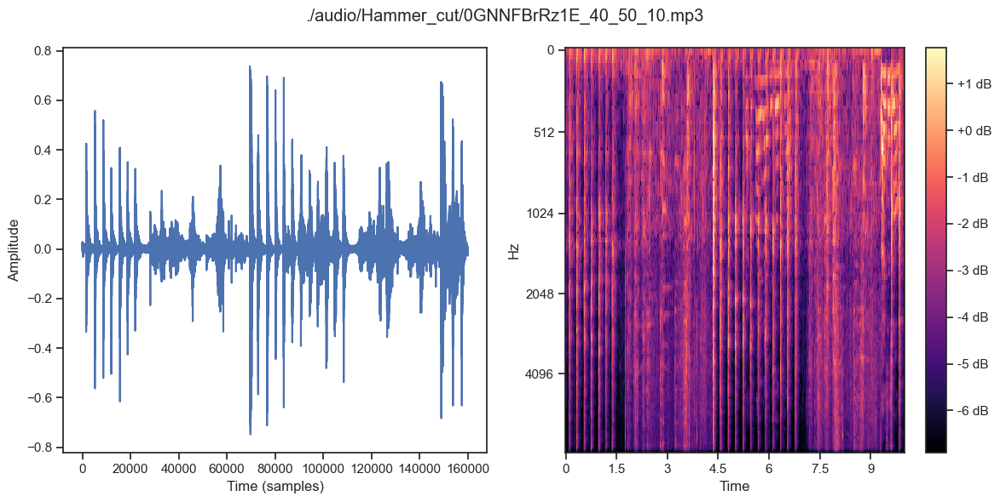

In [17]:
def plot_audio(mp3_path: str) -> None:
    """ 
    En utilisant matplotlib et create_mel_spectrogram() écrivez une fonction qui prend un mp3_path et trace
    à la fois la forme d'onde (graphique linéaire des amplitudes) et le spectrogramme mel côte à côte en tant que subplots.

    Utilisez le mp3_path comme titre principal unique pour tout le graphique
    """
    audio_data, _ = librosa.load(mp3_path, sr=sample_rate)
    spectrum = create_mel_spectrogram(mp3_path)
    
    # Set up the figure and subplots
    plt.figure(figsize=(12, 6))
    
    # Plot waveform
    plt.subplot(1, 2, 1)
    plt.plot(audio_data);
    plt.xlabel("Time (samples)")
    plt.ylabel("Amplitude")
    
    # Plot Mel spectrogram
    # Inspired by:
    # https://medium.com/analytics-vidhya/understanding-the-mel-spectrogram-fca2afa2ce53
    plt.subplot(1, 2, 2)
    librosa.display.specshow(spectrum, sr=sample_rate, x_axis="time", y_axis="mel", n_fft=n_fft, hop_length=stft_hopsize)
    plt.colorbar(format="%+2.0f dB")
    plt.gca().invert_yaxis()

    # Main title with mp3_path
    plt.suptitle(mp3_path)
    plt.tight_layout()
    plt.show()    

plot_audio("./audio/Hammer_cut/0GNNFBrRz1E_40_50_10.mp3")
# plot_audio("./test.mp3")